# Introduction to Recommendation systems

In this modern world we are overloaded with data and this data provides us the useful information. But it's not possible for the user to extract the information which interest them from these data. In order to help the user to find out information about the product , recommedation systems where developed. 

Recommeder system creates a similarity between the user and items and exploits the similarity between user/item to make recommendations.


What recommeder system can solve ?

1. It can help the user to find the right product.
2. It can increase the user engagement. For example, there's 40% more click on the google news due to recommendation.
3. It helps the item providers to deliver the items to the right user.In Amazon , 35 % products get sold due to recommendation.
4. It helps to make the contents more personalized.In Netflix most of the rented movies are from recommendations.

# Types of recommendations

There are mainly 6 types of the recommendations systems :-

1. Popularity based systems :- It works by recommeding items viewed and purchased by most people and are rated high.It is not a personalized recommendation.
2. Classification model based:- It works by understanding the features of the user and applying the classification algorithm to decide whether the user is     interested or not in the prodcut.
3. Content based recommedations:- It is based on the information on the contents of the item rather than on the user opinions.The main idea is if the user likes an item then he or she will like the "other" similar item.
4. Collaberative Filtering:- It is based on assumption that people like things similar to other things they like, and things that are liked by other people with similar taste. it is mainly of two types:
 a) User-User 
 b) Item -Item
 
5. Hybrid Approaches:- This system approach is to combine collaborative filtering, content-based filtering, and other approaches . 
6. Association rule mining :- Association rules capture the relationships between items based on their patterns of co-occurrence across transactions.

# Learning Outcomes:  
Online E-commerce websites like Amazon, Flipkart uses different recommendation models to provide different suggestions to different users. Amazon currently uses item-to-item collaborative filtering, which scales to massive data sets and produces high-quality recommendations in real-time.

#### ● Exploratory Data Analysis 
#### ● Creating a Recommendation system using real data 
#### ● Collaborative filtering 
# Data Description:  

Amazon Reviews data (data source) The repository has several datasets. For this case study, we are using the Electronics dataset.

## Domain: 
E-commerce

## Attribute Information:
 

● userId : Every user identified with a unique id 

● productId : Every product identified with a unique id 

● Rating : Rating of the corresponding product by the corresponding user 

● timestamp : Time of the rating ( ignore this column for this exercise)

# Steps and tasks: 

#### 1. Read and explore the given dataset.  (Rename column/add headers, plot histograms, find data characteristics) 
#### 2. Take a subset of the dataset to make it less sparse/ denser. ( For example, keep the users only who has given 50 or more number of ratings )  
#### 3. Split the data randomly into train and test dataset. ( For example, split it in 70/30 ratio) 
#### 4. Build Popularity Recommender model.  
#### 5. Build Collaborative Filtering model. 
#### 6. Evaluate both the models. ( Once the model is trained on the training data, it can be used to compute the error (RMSE) on predictions made on the test data.  
#### 7. Get top - K ( K = 5) recommendations. Since our goal is to recommend new products for each user based on his/her habits, we will recommend 5 new products.  
#### 8. Summarise your insights. 



# 1. Import the libraries 

In [1]:
#import the reqired libraries
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
import numpy as np
import pandas as pd
import math
import json
import time
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_squared_error

from sklearn.metrics.pairwise import cosine_similarity
from sklearn.model_selection import train_test_split
from sklearn.neighbors import NearestNeighbors
import joblib 
import scipy.sparse
from scipy.sparse import csr_matrix
from scipy.sparse.linalg import svds
import warnings; warnings.simplefilter('ignore')

#Importing Surprise and relevant packages to do some hyper parameter tuning through Grid Search
from surprise import Dataset
from surprise import Reader
from surprise.model_selection import cross_validate
from surprise.model_selection import GridSearchCV
from surprise import KNNBasic, KNNWithMeans, KNNWithZScore
from surprise import SVD, SVDpp, NMF
from surprise import SlopeOne, CoClustering
# %matplotlib inline

# 2. Loading Dataset and Preprocessing

In [2]:
# Import the dataset and give the column names
columns=['userId', 'productId', 'ratings','timestamp']
electronics_df=pd.read_csv('ratings_Electronics.csv',names=columns)

In [3]:
electronics_df.head()

,userId,productId,ratings,timestamp
0,AKM1MP6P0OYPR,0132793040,5.0,1365811200
1,A2CX7LUOHB2NDG,0321732944,5.0,1341100800
2,A2NWSAGRHCP8N5,0439886341,1.0,1367193600
3,A2WNBOD3WNDNKT,0439886341,3.0,1374451200
4,A1GI0U4ZRJA8WN,0439886341,1.0,1334707200


In [4]:
electronics_df.describe()

,ratings,timestamp
count,7.824482e+06,7.824482e+06
mean,4.012337e+00,1.338178e+09
std,1.380910e+00,6.900426e+07
min,1.000000e+00,9.127296e+08
25%,3.000000e+00,1.315354e+09
50%,5.000000e+00,1.361059e+09
75%,5.000000e+00,1.386115e+09
max,5.000000e+00,1.406074e+09


In [5]:
electronics_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7824482 entries, 0 to 7824481
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   userId     object 
 1   productId  object 
 2   ratings    float64
 3   timestamp  int64  
dtypes: float64(1), int64(1), object(2)
memory usage: 238.8+ MB


In [6]:
print('Number of missing values across columns: \n',electronics_df.isnull().sum())


Number of missing values across columns: 
 userId       0
productId    0
ratings      0
timestamp    0
dtype: int64


* There are no missing records in the dataset.

In [7]:
#Check the number of rows and columns
rows,columns=electronics_df.shape
print('Number of rows: ',rows)
print('Number of columns: ',columns)

Number of rows:  7824482
Number of columns:  4


array([[<AxesSubplot:title={'center':'ratings'}>,
        <AxesSubplot:title={'center':'timestamp'}>]], dtype=object)

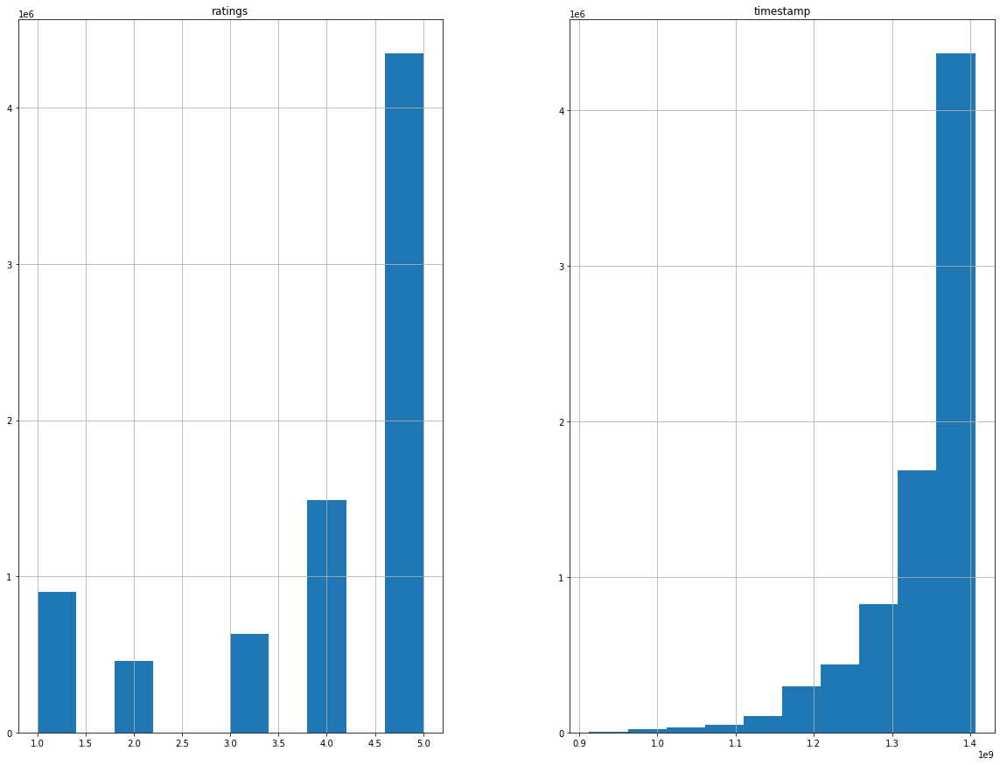

In [8]:
electronics_df.hist(figsize=(20, 15))
plt.show()

In [9]:
electronics_df.drop('timestamp',axis=1,inplace=True)

In [10]:
#Number of products is less than number of users, so item-item colaborative filtering would make sense
#instead of user-user colaborative filtering
print("Electronic Data Summary")
print("="*100)
print("\nTotal # of Ratings :",electronics_df.shape[0])
print("Total # of Users   :", len(np.unique(electronics_df.userId)))
print("Total # of Products  :", len(np.unique(electronics_df.productId)))
print("\n")
print("="*100)

Electronic Data Summary

Total # of Ratings : 7824482
Total # of Users   : 4201696
Total # of Products  : 476002




* Since the data is very big. Consider electronics_df1 named dataframe with subset of rows and all columns from 0 of dataset.

In [11]:
#Taking subset of the dataset
electronics_df1=electronics_df.iloc[:1824482,0:]

In [12]:
electronics_df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1824482 entries, 0 to 1824481
Data columns (total 3 columns):
 #   Column     Dtype  
---  ------     -----  
 0   userId     object 
 1   productId  object 
 2   ratings    float64
dtypes: float64(1), object(2)
memory usage: 41.8+ MB


In [13]:
#Summary statistics of rating variable
electronics_df1['ratings'].describe().transpose()

count    1.824482e+06
mean     3.986615e+00
std      1.394447e+00
min      1.000000e+00
25%      3.000000e+00
50%      5.000000e+00
75%      5.000000e+00
max      5.000000e+00
Name: ratings, dtype: float64

In [14]:
#Find the minimum and maximum ratings
print('Minimum rating is: %d' %(electronics_df1.ratings.min()))
print('Maximum rating is: %d' %(electronics_df1.ratings.max()))

Minimum rating is: 1
Maximum rating is: 5


* Rating are on the scale 1 to 5.

# 3. Exploratory Data Analysis

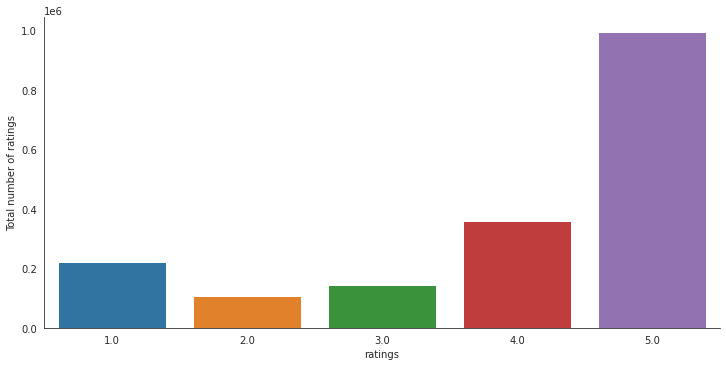

In [15]:
# Check the distribution of the rating
with sns.axes_style('white'):
    g = sns.factorplot("ratings", data=electronics_df1, aspect=2.0,kind='count')
    g.set_ylabels("Total number of ratings") 

<AxesSubplot:ylabel='ratings'>

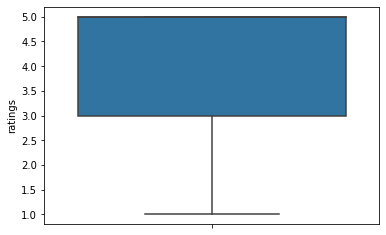

In [16]:
sns.boxplot(y='ratings',data=electronics_df1)

* We can see that more number of users have given the rating of 5.

In [17]:
# Number of unique user id  in the data
print('Number of unique users in Raw data = ', electronics_df1['userId'].nunique())
# Number of unique product id  in the data
print('Number of unique product in Raw data = ', electronics_df1['productId'].nunique())

Number of unique users in Raw data =  1268927
Number of unique product in Raw data =  102805


In [18]:
#Check the top 10 users based on ratings
electronics_df1.drop_duplicates(inplace=True)
most_rated=electronics_df1.groupby('userId').size().sort_values(ascending=False)
print('Top 10 users based on ratings: \n',most_rated[:10])

Top 10 users based on ratings: 
 userId
A5JLAU2ARJ0BO     438
A231WM2Z2JL0U3    249
A6FIAB28IS79      237
A3OXHLG6DIBRW8    165
A25HBO5V8S8SEA    165
A680RUE1FDO8B     157
AKT8TGIT6VVZ5     154
A203OCQQ12MAVT    145
AT6CZDCP4TRGA     140
A17BUUBOU0598B    136
dtype: int64


In [19]:
counts=electronics_df1.userId.value_counts()
electronics_df1_final=electronics_df1[electronics_df1.userId.isin(counts[counts>=10].index)]
print('Number of users who have rated 10 or more items =', len(electronics_df1_final))
print('Number of unique users in the final data = ', electronics_df1_final['userId'].nunique())
print('Number of unique products in the final data = ', electronics_df1_final['userId'].nunique())

Number of users who have rated 10 or more items = 93962
Number of unique users in the final data =  5867
Number of unique products in the final data =  5867


* electronics_df1_final has the users who have rated 25 or more items.

In [20]:
most_rated.describe().astype(int).T

count    1268927
mean           1
std            1
min            1
25%            1
50%            1
75%            1
max          438
dtype: int64

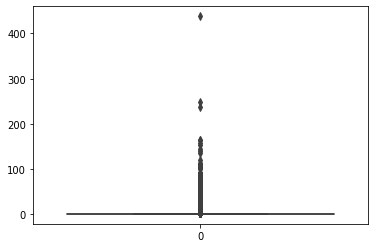

In [21]:
#Boxplot shows that we have few users who rate many items (appearing in outliers) but majority rate very few items

sns.boxplot(data=most_rated);

In [22]:
#Let us look at the quantile view to understand where the ratings are concentrated
quantiles = most_rated.quantile(np.arange(0,1.01,0.01), interpolation='higher')

<Figure size 720x720 with 0 Axes>

Text(0.5, 1.0, 'Quantiles and their Values')

<AxesSubplot:title={'center':'Quantiles and their Values'}>

Text(0, 0.5, '# ratings by user')

Text(0.5, 0, 'Value at the quantile')

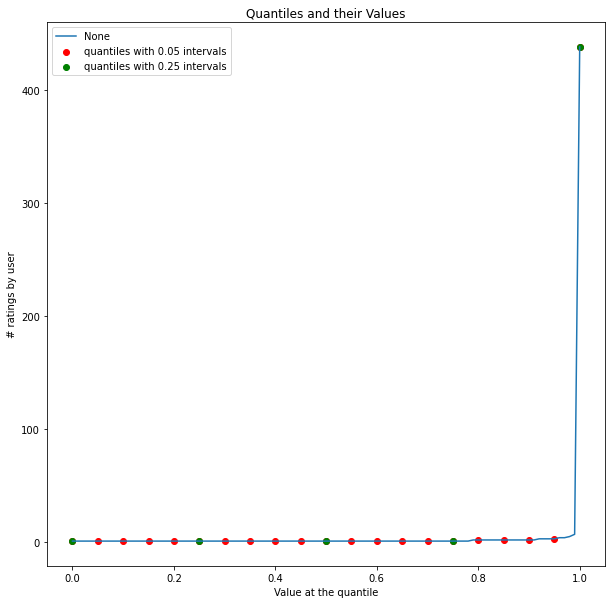

In [23]:
#We can see that all the ratings are clustered at the top end of the quantile
#Basically the outliers that we saw earlier are reflected here in the peak
plt.figure(figsize=(10,10))
plt.title("Quantiles and their Values")
quantiles.plot()
# quantiles with 0.05 difference
plt.scatter(x=quantiles.index[::5], y=quantiles.values[::5], c='red', label="quantiles with 0.05 intervals")
# quantiles with 0.25 difference
plt.scatter(x=quantiles.index[::25], y=quantiles.values[::25], c='green', label = "quantiles with 0.25 intervals")
plt.ylabel('# ratings by user')
plt.xlabel('Value at the quantile')
plt.legend(loc='best')
plt.show()

Text(0.5, 1.0, '# RATINGS per Product')

Text(0.5, 0, 'Product')

Text(0, 0.5, '# ratings per product')

[Text(-5000.0, 0, ''),
 Text(0.0, 0, ''),
 Text(5000.0, 0, ''),
 Text(10000.0, 0, ''),
 Text(15000.0, 0, ''),
 Text(20000.0, 0, ''),
 Text(25000.0, 0, ''),
 Text(30000.0, 0, ''),
 Text(35000.0, 0, '')]

<function matplotlib.pyplot.show(close=None, block=None)>

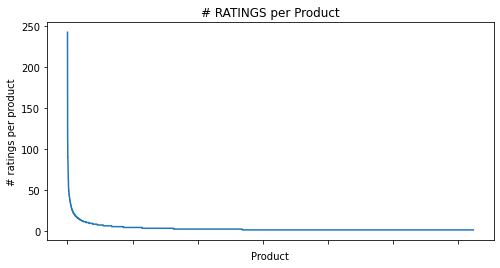

In [24]:
#Products also have skewed ratings with majority of the products having very few ratings
no_of_ratings_per_product = electronics_df1_final.groupby(by='productId')['ratings'].count().sort_values(ascending=False)

fig = plt.figure(figsize=plt.figaspect(.5))
ax = plt.gca()
plt.plot(no_of_ratings_per_product.values)
plt.title('# RATINGS per Product')
plt.xlabel('Product')
plt.ylabel('# ratings per product')
ax.set_xticklabels([])

plt.show

In [25]:
# AVerage ratings obtained by each product
ratings_mean_count = pd.DataFrame(electronics_df1_final.groupby('productId')['ratings'].mean())
ratings_mean_count['rating_counts'] = pd.DataFrame(electronics_df1_final.groupby('productId')['ratings'].count())
ratings_mean_count.head()




,ratings,rating_counts
productId,,
0594451647,5.00,1
0594481813,3.00,1
0970407998,2.50,2
0972683275,4.60,10
1400501466,3.75,8


In [26]:
#The maximum number of ratings received for a product is 242

ratings_mean_count['rating_counts'].max()

242

<Figure size 576x432 with 0 Axes>

<AxesSubplot:>

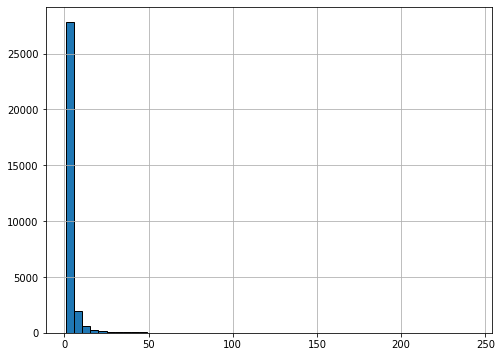

In [27]:
#### Majority of the products have received 1 rating only and it is a right skewed distribution
plt.figure(figsize=(8,6))
plt.rcParams['patch.force_edgecolor'] = True
ratings_mean_count['rating_counts'].hist(bins=50)

<Figure size 576x432 with 0 Axes>

<AxesSubplot:>

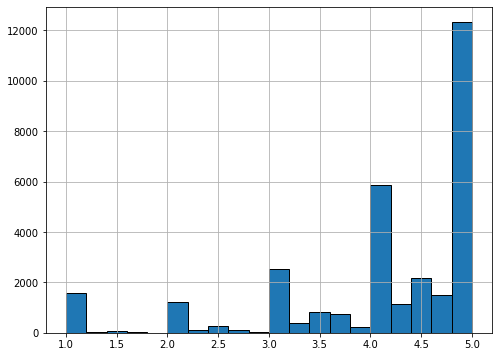

In [28]:
#We see a left skewed distribution for the ratings
#There are clusters at each of the points 1,2,3,4,5 as that is where the means are concentrated
plt.figure(figsize=(8,6))
plt.rcParams['patch.force_edgecolor'] = True
ratings_mean_count['ratings'].hist(bins=20)

<Figure size 576x432 with 0 Axes>

<Figure size 576x432 with 0 Axes>

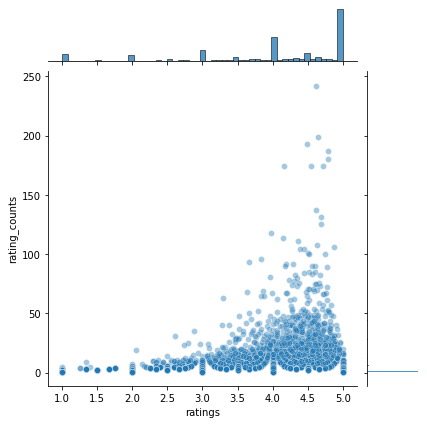

In [29]:
#From the joint plot below it seems that popular products (higher ratings) tend to be rated more frequently, majority have rated products in the higher range
#To make people more engaged (bottom of the chart) we can start by recommending them based on popularity based system and then
#slowly graduate them to collaborative system once we have sufficient number of data points to giver personlized recommendation
plt.figure(figsize=(8,6))
plt.rcParams['patch.force_edgecolor'] = True
sns.jointplot(x='ratings', y='rating_counts', data=ratings_mean_count, alpha=0.4)

<AxesSubplot:xlabel='productId'>

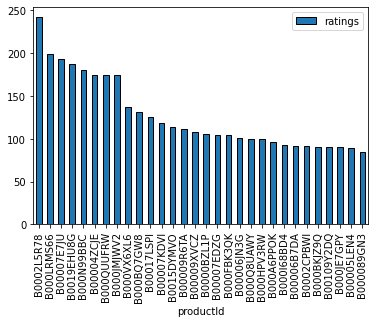

In [30]:
popular_products = pd.DataFrame(electronics_df1_final.groupby('productId')['ratings'].count())
most_popular = popular_products.sort_values('ratings', ascending=False)
most_popular.head(30).plot(kind = "bar")

In [32]:
no_of_ratings_per_user = electronics_df1_final.groupby(by='userId')['ratings'].count().sort_values(ascending=False)

# 5. ratings analysis in final dataset

In [34]:
#constructing the pivot table
final_ratings_matrix = electronics_df1_final.pivot(index = 'userId', columns ='productId', values = 'ratings').fillna(0)
final_ratings_matrix.head()

productId,0594451647,0594481813,0970407998,0972683275,1400501466,1400501520,1400501776,1400532620,1400532655,140053271X,...,B0019CWE34,B0019D320M,B0019D6H2M,B0019D6JAW,B0019D6JQ6,B0019D8H9I,B0019D8QMQ,B0019D8R70,B0019DKOVW,B0019EHU8G
userId,,,,,,,,,,,,,,,,,,,,,
A100NGGXRQF0AQ,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A100UD67AHFODS,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A100WO06OQR8BQ,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A1016Q5UDME15Z,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A101OAAMZYWQ3U,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


* It shows that it is a sparse matrix. So, many cells are filled with 0 values.

In [35]:
print('Shape of final_ratings_matrix: ', final_ratings_matrix.shape)

Shape of final_ratings_matrix:  (5867, 31204)


In [36]:
#Calucating the density of the rating marix
given_num_of_ratings = np.count_nonzero(final_ratings_matrix)
print('given_num_of_ratings = ', given_num_of_ratings)
possible_num_of_ratings = final_ratings_matrix.shape[0] * final_ratings_matrix.shape[1]
print('possible_num_of_ratings = ', possible_num_of_ratings)
density = (given_num_of_ratings/possible_num_of_ratings)
density *= 100
print ('density: {:4.2f}%'.format(density))

given_num_of_ratings =  93962
possible_num_of_ratings =  183073868
density: 0.05%


* The density value of the matrix also shows that it is a sparse matrix.

# 6. Splitting the data

In [37]:
#Split the data randomnly into train and test datasets into 70:30 ratio
train_data, test_data = train_test_split(electronics_df1_final, test_size = 0.3, random_state=42)
train_data.head()

,userId,productId,ratings
1164616,ARQ945F4OIWVI,B000MFHQM8,5.0
243498,A1ZG9WMHNMGY62,B000089GN4,5.0
1698442,A2QS722FL9DLQ4,B00158QASW,5.0
1026659,A2OBDNQ5ZYU1L8,B000I3NUQ0,5.0
1562117,A3REBHTMMJ9MIB,B0011000R6,4.0


In [38]:
print('Shape of training data: ',train_data.shape)
print('Shape of testing data: ',test_data.shape)

Shape of training data:  (65773, 3)
Shape of testing data:  (28189, 3)


# 7. Building Popularity Based Recommender model

In [39]:
#Count of user_id for each unique product as recommendation score 
train_data_grouped = train_data.groupby('productId').agg({'userId': 'count'}).reset_index()
train_data_grouped.rename(columns = {'userId': 'score'},inplace=True)
train_data_grouped.head(10)

,productId,score
0,0594451647,1
1,0594481813,1
2,0970407998,2
3,0972683275,8
4,1400501466,8
5,1400501520,1
6,1400501776,3
7,1400532620,4
8,1400532655,11
9,140053271X,6


In [40]:
#Sort the products on recommendation score 
train_data_sort = train_data_grouped.sort_values(['score', 'productId'], ascending = [0,1]) 
      
#Generate a recommendation rank based upon score 
train_data_sort['rank'] = train_data_sort['score'].rank(ascending=0, method='first') 
          
#Get the top 5 recommendations 
popularity_recommendations = train_data_sort.head(5) 
popularity_recommendations 

,productId,score,rank
8666,B0002L5R78,158,1.0
17650,B000LRMS66,134,2.0
1285,B00004ZCJE,130,3.0
4007,B00007E7JU,130,4.0
18420,B000N99BBC,123,5.0


In [41]:
# Use popularity based recommender model to make predictions
def recommend(user_id):     
    user_recommendations = popularity_recommendations 
          
    #Add user_id column for which the recommendations are being generated 
    user_recommendations['userId'] = user_id 
      
    #Bring user_id column to the front 
    cols = user_recommendations.columns.tolist() 
    cols = cols[-1:] + cols[:-1] 
    user_recommendations = user_recommendations[cols] 
          
    return user_recommendations 

In [42]:
# Since, it is a Popularity recommender model, so, all the three users are given the same recommendations. Here, we predict the products based on the popularity. It is not personalized to particular user. It is a non-personalized recommender system.
find_recom = [10,100,150]   # This list is user choice.
for i in find_recom:
    print("The list of recommendations for the userId: %d\n" %(i))
    print(recommend(i))    
    print("\n") 

The list of recommendations for the userId: 10

       userId   productId  score  rank
8666       10  B0002L5R78    158   1.0
17650      10  B000LRMS66    134   2.0
1285       10  B00004ZCJE    130   3.0
4007       10  B00007E7JU    130   4.0
18420      10  B000N99BBC    123   5.0


The list of recommendations for the userId: 100

       userId   productId  score  rank
8666      100  B0002L5R78    158   1.0
17650     100  B000LRMS66    134   2.0
1285      100  B00004ZCJE    130   3.0
4007      100  B00007E7JU    130   4.0
18420     100  B000N99BBC    123   5.0


The list of recommendations for the userId: 150

       userId   productId  score  rank
8666      150  B0002L5R78    158   1.0
17650     150  B000LRMS66    134   2.0
1285      150  B00004ZCJE    130   3.0
4007      150  B00007E7JU    130   4.0
18420     150  B000N99BBC    123   5.0




In [43]:
#Calculating the RMSE of the popularity based recommendation system
#Rating present in the test data is the actual rating (Act_rating)
test_data2 = test_data.copy()
#ratings.drop(['timestamp'], axis=1,inplace=True)
test_data2.drop(['userId'],axis=1,inplace=True)
test_data2.rename(columns = {'ratings':'Act_rating'}, inplace = True)

In [44]:
#Count of user_id for each unique product as recommendation score 
train_data_grouped2 = train_data.groupby('productId').agg({'ratings': 'sum'}).reset_index()
train_data_grouped2.rename(columns = {'ratings': 'Sum_rating'},inplace=True)
train_data_grouped2.head()


,productId,Sum_rating
0,0594451647,5.0
1,0594481813,3.0
2,0970407998,5.0
3,0972683275,36.0
4,1400501466,30.0


In [45]:
train_data_inner = pd.merge(train_data_grouped2, train_data_sort)
train_data_inner.head()

,productId,Sum_rating,score,rank
0,0594451647,5.0,1,10074.0
1,0594481813,3.0,1,10075.0
2,0970407998,5.0,2,5852.0
3,0972683275,36.0,8,1182.0
4,1400501466,30.0,8,1183.0


In [46]:
#Obtain the average rating of the product across users
train_data_inner["Avg_Rating"] = train_data_inner["Sum_rating"]/train_data_inner["score"]
train_data_inner.head()

,productId,Sum_rating,score,rank,Avg_Rating
0,0594451647,5.0,1,10074.0,5.00
1,0594481813,3.0,1,10075.0,3.00
2,0970407998,5.0,2,5852.0,2.50
3,0972683275,36.0,8,1182.0,4.50
4,1400501466,30.0,8,1183.0,3.75


In [47]:
#Merge the train data having average rating with the test data having actual rating at product level
test_data_inner = pd.merge(train_data_inner, test_data2)
test_data_inner.head()

,productId,Sum_rating,score,rank,Avg_Rating,Act_rating
0,0972683275,36.0,8,1182.0,4.500000,5.0
1,0972683275,36.0,8,1182.0,4.500000,5.0
2,1400501520,5.0,1,10076.0,5.000000,5.0
3,1400501520,5.0,1,10076.0,5.000000,4.0
4,1400501776,11.0,3,3996.0,3.666667,4.0


In [48]:
#RMSE for popularity based recommender system is 1.09
mse = mean_squared_error(test_data_inner["Act_rating"], test_data_inner["Avg_Rating"])
rmse = math.sqrt(mse)
print("RMSE for popularity based recommendation system:", rmse)

RMSE for popularity based recommendation system: 1.2262552418526071


## Popularity recommender using Turicreate

In [49]:
import turicreate
train_data2 = turicreate.SFrame(train_data)
test_data2 = turicreate.SFrame(test_data)

In [50]:
popularity_model = turicreate.popularity_recommender.create(train_data2, user_id='userId', item_id='productId', target='ratings')

Preparing data set.

Data has 65773 observations with 5867 users and 25285 items.

Data prepared in: 0.2085s

65773 observations to process; with 25285 unique items.

In [51]:
#Recommend for a given set of users, since there are top 5 recommendation for 5 users, total rows will be 25
popularity_recomm = popularity_model.recommend(users=['AKM1MP6P0OYPR',
'A2CX7LUOHB2NDG',
'A2NWSAGRHCP8N5',
'A2WNBOD3WNDNKT',
'A1GI0U4ZRJA8WN'],k=5)
popularity_recomm.print_rows(num_rows=25)

+----------------+------------+-------+------+
|     userId     | productId  | score | rank |
+----------------+------------+-------+------+
| AKM1MP6P0OYPR  | B0000E6S12 |  5.0  |  1   |
| AKM1MP6P0OYPR  | B00005AR4K |  5.0  |  2   |
| AKM1MP6P0OYPR  | B0014EHYZA |  5.0  |  3   |
| AKM1MP6P0OYPR  | B000F6K00Y |  5.0  |  4   |
| AKM1MP6P0OYPR  | B000MFHQM8 |  5.0  |  5   |
| A2CX7LUOHB2NDG | B0000E6S12 |  5.0  |  1   |
| A2CX7LUOHB2NDG | B00005AR4K |  5.0  |  2   |
| A2CX7LUOHB2NDG | B0014EHYZA |  5.0  |  3   |
| A2CX7LUOHB2NDG | B000F6K00Y |  5.0  |  4   |
| A2CX7LUOHB2NDG | B000MFHQM8 |  5.0  |  5   |
| A2NWSAGRHCP8N5 | B0000E6S12 |  5.0  |  1   |
| A2NWSAGRHCP8N5 | B00005AR4K |  5.0  |  2   |
| A2NWSAGRHCP8N5 | B0014EHYZA |  5.0  |  3   |
| A2NWSAGRHCP8N5 | B000F6K00Y |  5.0  |  4   |
| A2NWSAGRHCP8N5 | B000MFHQM8 |  5.0  |  5   |
| A2WNBOD3WNDNKT | B0000E6S12 |  5.0  |  1   |
| A2WNBOD3WNDNKT | B00005AR4K |  5.0  |  2   |
| A2WNBOD3WNDNKT | B0014EHYZA |  5.0  |  3   |
| A2WNBOD3WND

In [52]:
pop_rmse = popularity_model.evaluate_rmse(test_data2,'ratings')
print(pop_rmse)
#The RMSE value is 1.23 for the popularity based model
pop_rmse["rmse_overall"]

Using default 16 lambda workers.

To maximize the degree of parallelism, add the following code to the beginning of the program:

"turicreate.config.set_runtime_config('TURI_DEFAULT_NUM_PYLAMBDA_WORKERS', 32)"

Note that increasing the degree of parallelism also increases the memory footprint.

{'rmse_by_user': Columns:
	userId	str
	rmse	float
	count	int

Rows: 5782

Data:
+----------------+--------------------+-------+
|     userId     |        rmse        | count |
+----------------+--------------------+-------+
| A23QSTB241NRF3 | 0.5785419118799026 |   2   |
| ALYU98KL3VUGF  | 0.799294543353656  |   2   |
| A3EQQHWJ1EEYEU | 0.7391147333206416 |   3   |
| A1DBFPKBW56P9T | 1.3483850937737005 |   4   |
| A1VV5SARD15R23 | 1.5147482945185549 |   3   |
| A3HRTSBFHCCOJK | 1.218402639612701  |   6   |
| APQY23KSBBCNO  | 2.4809444352769856 |   6   |
| A21EHWHI9XQY10 | 0.4656573146573322 |   2   |
| A3BUNHF07TGZS3 | 1.2829797322903953 |   7   |
| A3M1BNMWE8A633 | 2.0021158662172205 |   8   |
+----------------+--------------------+-------+
[5782 rows x 3 columns]
Note: Only the head of the SFrame is printed.
You can use print_rows(num_rows=m, num_columns=n) to print more rows and columns., 'rmse_by_item': Columns:
	productId	str
	rmse	float
	count	int

Rows: 14659

Data:
+-----------

1.2385815499099548

# 8. Building Collaborative Filtering recommender model.

## Training the model for item-item similarity recommender


In [53]:
#Training the model for item-item similarity recommender
#This model first computes the similarity between items using the observations of users who have interacted with both items. Given a similarity between item i and j, S(i,j), it scores an item j for user u using a weighted average of the user’s previous observations Iu.
item_sim_model = turicreate.item_similarity_recommender.create(train_data2, user_id='userId', item_id='productId', target='ratings', similarity_type='cosine')

Preparing data set.

Data has 65773 observations with 5867 users and 25285 items.

Data prepared in: 0.145309s

Training model from provided data.

Gathering per-item and per-user statistics.

+--------------------------------+------------+

| Elapsed Time (Item Statistics) | % Complete |

+--------------------------------+------------+

| 4.095ms                        | 17         |

| 23.228ms                       | 100        |

+--------------------------------+------------+

Setting up lookup tables.

Processing data in one pass using dense lookup tables.

+-------------------------------------+------------------+-----------------+

| Elapsed Time (Constructing Lookups) | Total % Complete | Items Processed |

+-------------------------------------+------------------+-----------------+

| 1.37s                               | 0                | 1               |

| 2.62s                               | 100              | 25285           |

+-------------------------------------+------------------+-----------------+

Finalizing lookup tables.

Generating candidate set for working with new users.

Finished training in 3.653s

In [54]:
item_sim_recomm = item_sim_model.recommend(users=['AKM1MP6P0OYPR',
'A2CX7LUOHB2NDG',
'A2NWSAGRHCP8N5',
'A2WNBOD3WNDNKT',
'A1GI0U4ZRJA8WN'],k=5)
item_sim_recomm.print_rows(num_rows=25)

+----------------+------------+----------------------+------+
|     userId     | productId  |        score         | rank |
+----------------+------------+----------------------+------+
| AKM1MP6P0OYPR  | B000F2BLU6 | 0.011685940027236939 |  1   |
| AKM1MP6P0OYPR  | B000BCZ8WM | 0.011685940027236939 |  2   |
| AKM1MP6P0OYPR  | B000095ISH | 0.011685940027236939 |  3   |
| AKM1MP6P0OYPR  | B00002NDRF | 0.011684997081756592 |  4   |
| AKM1MP6P0OYPR  | B0000VP1WQ | 0.011684997081756592 |  5   |
| A2CX7LUOHB2NDG | B000F2BLU6 | 0.011685940027236939 |  1   |
| A2CX7LUOHB2NDG | B000BCZ8WM | 0.011685940027236939 |  2   |
| A2CX7LUOHB2NDG | B000095ISH | 0.011685940027236939 |  3   |
| A2CX7LUOHB2NDG | B00002NDRF | 0.011684997081756592 |  4   |
| A2CX7LUOHB2NDG | B0000VP1WQ | 0.011684997081756592 |  5   |
| A2NWSAGRHCP8N5 | B000F2BLU6 | 0.011685940027236939 |  1   |
| A2NWSAGRHCP8N5 | B000BCZ8WM | 0.011685940027236939 |  2   |
| A2NWSAGRHCP8N5 | B000095ISH | 0.011685940027236939 |  3   |
| A2NWSA

In [55]:
#Get the item-item recommender RMSE value, value is 4.35 which is much worse than popularity based recommender system
item_rmse = item_sim_model.evaluate_rmse(test_data2,'ratings')
item_rmse["rmse_overall"]

4.353845729226467

In [56]:
electronics_df_CF = pd.concat([train_data, test_data]).reset_index()
electronics_df_CF.head()

,index,userId,productId,ratings
0,1164616,ARQ945F4OIWVI,B000MFHQM8,5.0
1,243498,A1ZG9WMHNMGY62,B000089GN4,5.0
2,1698442,A2QS722FL9DLQ4,B00158QASW,5.0
3,1026659,A2OBDNQ5ZYU1L8,B000I3NUQ0,5.0
4,1562117,A3REBHTMMJ9MIB,B0011000R6,4.0


## User Based Collaborative Filtering model

### Matrix Factorization based recommender using Turicreate

In [78]:
#Build a matrix based factorization model recommender system
#FactorizationRecommender trains a model capable of predicting a score for each possible combination of users and items. The internal coefficients of the model are learned from known scores of users and items. Recommendations are then based on these scores.
factorization_model = turicreate.factorization_recommender.create(train_data2, user_id='userId', item_id='productId', target='ratings')

Preparing data set.

Data has 65773 observations with 5867 users and 25285 items.

Data prepared in: 0.158635s

Training factorization_recommender for recommendations.

+--------------------------------+--------------------------------------------------+----------+

| Parameter                      | Description                                      | Value    |

+--------------------------------+--------------------------------------------------+----------+

| num_factors                    | Factor Dimension                                 | 8        |

| regularization                 | L2 Regularization on Factors                     | 1e-08    |

| solver                         | Solver used for training                         | sgd      |

| linear_regularization          | L2 Regularization on Linear Coefficients         | 1e-10    |

| max_iterations                 | Maximum Number of Iterations                     | 50       |

+--------------------------------+--------------------------------------------------+----------+

Optimizing model using SGD; tuning step size.

Using 10000 / 65773 points for tuning the step size.

+---------+-------------------+------------------------------------------+

| Attempt | Initial Step Size | Estimated Objective Value                |

+---------+-------------------+------------------------------------------+

| 0       | 25                | Not Viable                               |

| 1       | 6.25              | Not Viable                               |

| 2       | 1.5625            | No Decrease (23.3963 >= 1.40767)         |

| 3       | 0.390625          | 0.0818569                                |

| 4       | 0.195312          | 0.139344                                 |

| 5       | 0.0976562         | 0.28945                                  |

+---------+-------------------+------------------------------------------+

| Final   | 0.390625          | 0.0818569                                |

+---------+-------------------+------------------------------------------+

Starting Optimization.

+---------+--------------+-------------------+-----------------------+-------------+

| Iter.   | Elapsed Time | Approx. Objective | Approx. Training RMSE | Step Size   |

+---------+--------------+-------------------+-----------------------+-------------+

| Initial | 89us         | 1.38735           | 1.17786               |             |

+---------+--------------+-------------------+-----------------------+-------------+

| 1       | 246.338ms    | DIVERGED          | DIVERGED              | 0.390625    |

| RESET   | 253.317ms    | 1.38734           | 1.17786               |             |

| 1       | 442.662ms    | 1.51121           | 1.22927               | 0.195312    |

| 2       | 695.737ms    | 0.99734           | 0.998651              | 0.116134    |

| 3       | 1.03s        | 0.809315          | 0.899612              | 0.0856819   |

| 4       | 1.27s        | 0.701279          | 0.83742               | 0.0580668   |

| 5       | 1.49s        | 0.64369           | 0.802299              | 0.0491185   |

| 9       | 2.35s        | 0.433204          | 0.658161              | 0.0316075   |

| 24      | 5.70s        | 0.0901284         | 0.300034              | 0.0151466   |

| 49      | 11.31s       | 0.0232354         | 0.151949              | 0.008868    |

| 50      | 11.51s       | 0.0224028         | 0.149181              | 0.00873464  |

+---------+--------------+-------------------+-----------------------+-------------+

Optimization Complete: Maximum number of passes through the data reached.

Computing final objective value and training RMSE.

Final objective value: 0.0205349

Final training RMSE: 0.142784

In [79]:
#Recommend top 5 products for 5 users basis matrix factorization method
factorization_recomm = factorization_model.recommend(users=['AKM1MP6P0OYPR',
'A2CX7LUOHB2NDG',
'A2NWSAGRHCP8N5',
'A2WNBOD3WNDNKT',
'A1GI0U4ZRJA8WN'],k=5)
factorization_recomm.print_rows(num_rows=5)

+---------------+------------+--------------------+------+
|     userId    | productId  |       score        | rank |
+---------------+------------+--------------------+------+
| AKM1MP6P0OYPR | B00000J47F | 7.031700301082991  |  1   |
| AKM1MP6P0OYPR | B00005KJVW | 6.8445953606685626 |  2   |
| AKM1MP6P0OYPR | B000VDG0UK | 6.841309475811385  |  3   |
| AKM1MP6P0OYPR | B0002DCJT0 | 6.802322316082381  |  4   |
| AKM1MP6P0OYPR | B00006BA8M | 6.697113680752181  |  5   |
+---------------+------------+--------------------+------+
[25 rows x 4 columns]



In [80]:
fcm_rmse2 = factorization_model.evaluate_rmse(test_data2,'ratings')
fcm_rmse2["rmse_overall"]

1.2686105252407158

## Condensing matrix 
#### Merging the datasets to get data where each product has atleast 25 ratings and each user has given atleast 25 ratings
#### This makes the matrix more dense and also allows GridSearch algo to run, else it is failing
#### Taking a 10% random sample with full data as the SVD decomposition is failing

#### * Use K nearest neighbour (basic, with means, and normalized (z-score))
#### * Support Vector Decomposition (SVD)
#### * Co-clustering

In [81]:
rts_gp = electronics_df.groupby(by=['ratings']).agg({'userId': 'count'}).reset_index()
rts_gp.columns = ['ratings', 'Count']

#Subsetting the data to keep products having at least 25 ratings
prod_ge_25=electronics_df.groupby("productId").filter(lambda x:x['ratings'].count() >= 25)
#Subsetting the data to keep users who have given at least 25 ratings
user_ge_25=electronics_df.groupby("userId").filter(lambda x:x['ratings'].count() >= 25)
user_ge_25.drop(['ratings'],inplace=True,axis=1)
user_prod_ge_25 = pd.merge(prod_ge_25,user_ge_25)
user_prod_ge_25.shape

(255557, 3)

In [82]:
#Taking a 10% random sample with full data as the SVD decomposition is failing
new_df2 = user_prod_ge_25.sample(frac=0.25, replace=False, random_state=0)

In [83]:
# Set Rating Scale from 1 to 5
#We are running basic algorithms to check which one works best
reader = Reader(rating_scale=(1, 5))

# Load data with rating scale
#data = Dataset.load_from_df(new_df, reader)
data = Dataset.load_from_df(new_df2,reader)

In [84]:
knnbasic_cv = cross_validate(KNNBasic(), data, cv=5, n_jobs=5, verbose=True)
knnmeans_cv = cross_validate(KNNWithMeans(), data, cv=5, n_jobs=5, verbose=True)
knnz_cv = cross_validate(KNNWithZScore(), data, cv=5, n_jobs=5, verbose=True)
svd_cv = cross_validate(SVD(), data, cv=5, n_jobs=5, verbose=True)
svdpp_cv = cross_validate(SVDpp(), data, cv=5, n_jobs=5, verbose=True)
nmf_cv = cross_validate(NMF(), data, cv=5, n_jobs=5, verbose=True)
slope_cv = cross_validate(SlopeOne(), data, cv=5, n_jobs=5, verbose=True)
coclus_cv = cross_validate(CoClustering(), data, cv=5, n_jobs=5, verbose=True)

Evaluating RMSE, MAE of algorithm KNNBasic on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.1150  1.1142  1.1223  1.1230  1.1171  1.1183  0.0036  
MAE (testset)     0.8533  0.8569  0.8588  0.8575  0.8573  0.8568  0.0019  
Fit time          2.18    2.15    2.16    2.11    2.08    2.14    0.04    
Test time         0.33    0.27    0.28    0.28    0.26    0.29    0.02    
Evaluating RMSE, MAE of algorithm KNNWithMeans on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.1369  1.1173  1.1223  1.1368  1.1204  1.1267  0.0084  
MAE (testset)     0.8172  0.8066  0.8085  0.8199  0.8097  0.8124  0.0052  
Fit time          2.63    2.33    2.45    2.30    2.24    2.39    0.14    
Test time         0.54    0.29    0.29    0.33    0.29    0.35    0.10    
Evaluating RMSE, MAE of algorithm KNNWithZScore on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean  

In [85]:
print('Algorithm\t RMSE\t\t MAE')
print()
print('KNN Basic', '\t', round(knnbasic_cv['test_rmse'].mean(), 4), '\t', round(knnbasic_cv['test_mae'].mean(), 4))
print('KNN Means', '\t', round(knnmeans_cv['test_rmse'].mean(), 4), '\t', round(knnmeans_cv['test_mae'].mean(), 4))
print('KNN ZScore', '\t', round(knnz_cv['test_rmse'].mean(), 4), '\t', round(knnz_cv['test_mae'].mean(), 4))
print()
print('SVD', '\t\t', round(svd_cv['test_rmse'].mean(), 4), '\t', round(svd_cv['test_mae'].mean(), 4))
print('SVDpp', '\t\t', round(svdpp_cv['test_rmse'].mean(), 4), '\t', round(svdpp_cv['test_mae'].mean(), 4))
print('NMF', '\t\t', round(nmf_cv['test_rmse'].mean(), 4), '\t', round(nmf_cv['test_mae'].mean(), 4))
print()
print('SlopeOne', '\t', round(slope_cv['test_rmse'].mean(), 4), '\t', round(slope_cv['test_mae'].mean(), 4))
print('CoClustering', '\t', round(coclus_cv['test_rmse'].mean(), 4), '\t', round(coclus_cv['test_mae'].mean(), 4))
print()

Algorithm	 RMSE		 MAE

KNN Basic 	 1.1183 	 0.8568
KNN Means 	 1.1267 	 0.8124
KNN ZScore 	 1.1311 	 0.8146

SVD 		 1.0512 	 0.7891
SVDpp 		 1.0473 	 0.7802
NMF 		 1.281 	 0.9952

SlopeOne 	 1.1397 	 0.8239
CoClustering 	 1.1742 	 0.8185



<Figure size 1440x360 with 0 Axes>

<AxesSubplot:>

Text(0.5, 1.0, 'Comparison of Algorithms on RMSE')

Text(0.5, 0, 'Algorithms')

Text(0, 0.5, 'RMSE Value')

<AxesSubplot:>

Text(0.5, 1.0, 'Comparison of Algorithms on MAE')

Text(0.5, 0, 'Algorithms')

Text(0, 0.5, 'MAE Value')

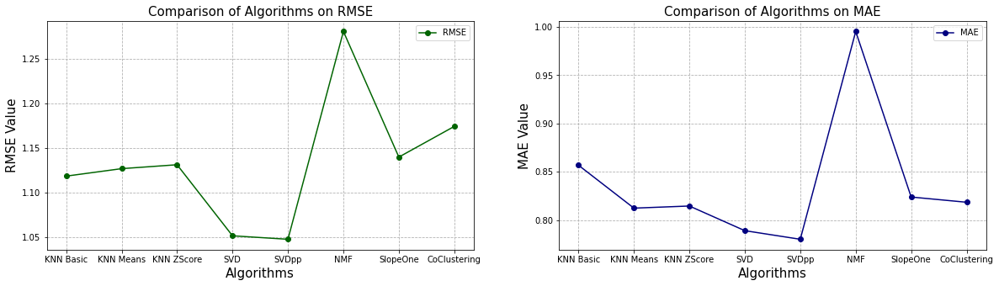

In [86]:
x_algo = ['KNN Basic', 'KNN Means', 'KNN ZScore', 'SVD', 'SVDpp', 'NMF', 'SlopeOne', 'CoClustering']
all_algos_cv = [knnbasic_cv, knnmeans_cv, knnz_cv, svd_cv, svdpp_cv, nmf_cv, slope_cv, coclus_cv]

rmse_cv = [round(res['test_rmse'].mean(), 4) for res in all_algos_cv]
mae_cv = [round(res['test_mae'].mean(), 4) for res in all_algos_cv]

plt.figure(figsize=(20,5))

plt.subplot(1, 2, 1)
plt.title('Comparison of Algorithms on RMSE', loc='center', fontsize=15)
plt.plot(x_algo, rmse_cv, label='RMSE', color='darkgreen', marker='o')
plt.xlabel('Algorithms', fontsize=15)
plt.ylabel('RMSE Value', fontsize=15)
plt.legend()
plt.grid(ls='dashed')

plt.subplot(1, 2, 2)
plt.title('Comparison of Algorithms on MAE', loc='center', fontsize=15)
plt.plot(x_algo, mae_cv, label='MAE', color='navy', marker='o')
plt.xlabel('Algorithms', fontsize=15)
plt.ylabel('MAE Value', fontsize=15)
plt.legend()
plt.grid(ls='dashed')

plt.show()

# 9. Grid Searching on best performing models ( SVD and SVDPP algorithms )


In [94]:
# Split the data into 70% / 30%
# trainset, testset = train_test_split(data, test_size=.30)
# trainset = dataset_svd.build_full_trainset()
# testset = trainset.build_anti_testset()
raw_ratings = data.raw_ratings                         # 90% trainset, 10% testset                                                
threshold = int(.9 * len(raw_ratings))                                     
trainset_raw_ratings = raw_ratings[:threshold]                             
test_raw_ratings = raw_ratings[threshold:]             
data.raw_ratings = trainset_raw_ratings        


In [96]:
from surprise import accuracy                                              

# Parameter space
svd_param_grid = {'n_epochs': [20, 25], 
                  'lr_all': [0.007, 0.009, 0.01],
                  'reg_all': [0.4, 0.6]}

svdpp_gs = GridSearchCV(SVDpp, svd_param_grid, measures=['rmse', 'mae'], cv=5, n_jobs=5)
svdpp_gs.fit(data)
algo_svdpp = svdpp_gs.best_estimator['rmse']    
# retrain on the whole train set                      
# 
trainset = data.build_full_trainset()                 
algo_svdpp.fit(trainset)
# now test on the trainset                                                 
testset = data.construct_testset(trainset_raw_ratings)                     
predictions_train = algo_svdpp.test(testset)                                           
print('Accuracy on the trainset:')                                         
accuracy.rmse(predictions_train)                                                 

# now test on the testset                                                  
testset = data.construct_testset(test_raw_ratings)                         
pred_svdpp=algo_svdpp.test(testset)
print('Accuracy on the testset:')                                          
accuracy.rmse(pred_svdpp)  


svd_gs = GridSearchCV(SVD, svd_param_grid, measures=['rmse', 'mae'], cv=5, n_jobs=5)
svd_gs.fit(data)
algo_svd = svd_gs.best_estimator['rmse']    
# retrain on the whole train set                      
trainset = data.build_full_trainset()                  
algo_svd.fit(trainset)
# now test on the trainset                                                 
testset = data.construct_testset(trainset_raw_ratings)                     
predictions_train = algo_svd.test(testset)                                           
print('Accuracy on the trainset:')                                         
accuracy.rmse(predictions_train)                                                 

# now test on the testset                                                  
testset = data.construct_testset(test_raw_ratings)                         
pred_svd=algo_svd.test(testset)
print('Accuracy on the testset:')                                          
accuracy.rmse(pred_svd)  




Accuracy on the trainset:
RMSE: 0.8331


0.8331049844232481

Accuracy on the testset:
RMSE: 1.0405


1.0404897845858163

Accuracy on the trainset:
RMSE: 0.7766


0.7766243501964588

Accuracy on the testset:
RMSE: 1.0409


1.0409316936319148

user: 150        item: 10000      r_ui = 4.00   est = 4.27   {'was_impossible': False}


In [97]:
print('SVDpp - RMSE:', round(svdpp_gs.best_score['rmse'], 4), '; MAE:', round(svdpp_gs.best_score['mae'], 4))
print('SVD   - RMSE:', round(svd_gs.best_score['rmse'], 4), '; MAE:', round(svd_gs.best_score['mae'], 4))
print('RMSE =', svdpp_gs.best_params['rmse'])
print('MAE =', svdpp_gs.best_params['mae'])
print('RMSE =', svd_gs.best_params['rmse'])
print('MAE =', svd_gs.best_params['mae'])

SVDpp - RMSE: 1.0469 ; MAE: 0.7819
SVD   - RMSE: 1.047 ; MAE: 0.7831
RMSE = {'n_epochs': 20, 'lr_all': 0.009, 'reg_all': 0.6}
MAE = {'n_epochs': 25, 'lr_all': 0.01, 'reg_all': 0.4}
RMSE = {'n_epochs': 20, 'lr_all': 0.009, 'reg_all': 0.6}
MAE = {'n_epochs': 25, 'lr_all': 0.01, 'reg_all': 0.4}


In [107]:
from collections import defaultdict
def get_top_n_recommendations(reccomemndations, n=5):
    # First map the reccommendations to each user.
    top_n = defaultdict(list)
    for uid, iid, true_r, est, _ in reccomemndations:
        top_n[uid].append((iid, est))

    #sort predictions for each user and retrieve the k highest ones.
    for uid, user_ratings in top_n.items():
        user_ratings.sort(key=lambda x: x[1], reverse=True)
        top_n[uid] = user_ratings[:n]

    return top_n

In [109]:
top_5 = get_top_n_recommendations(pred_svd, n=5)
for uid, user_ratings in top_5.items():
    print(uid, [iid for (iid, _) in user_ratings])


A249FZIEJXNWR ['B007YCA6UG']
A1OCDMMZ8B5BIE ['B0014IUWU0']
AMP7TQRWAIE84 ['B000H6AY6M']
A379LXOWA6ZXGD ['B005VP9MO4']
A3DFGT63ADLNI0 ['B00126U0VA']
A28PQWS9Z01FG3 ['B006C2GNDS']
AH3LF9RAD1O2V ['B001KZ6C74']
A2HM0AZ8WQFWU7 ['B0006BGV2Y', 'B000XY4AD6', 'B000VHQA6U']
AP8EXADSLHZET ['B003B48UQ8']
A183V4P6U4CFBF ['B003F5NS9W']
A24W1A0CW6CW5R ['B002MAPSDA', 'B005F77Z9C']
A3RTCA21S7BQ3P ['B00HFFDDLG', 'B006T9FURY']
A3M2TMPK88UCSR ['B001L2WCE8']
AODZQ5RTAM3EY ['B0041UJVI2']
A3F5NFPJ5XTT2Q ['B00361EZX8']
A2SBFXPN5V6A6X ['B0049YQVHE']
A2WO3RGJHZIKHX ['B005FYNSPK']
AVJ6URCLNJQD2 ['B008ABOJKS']
A50W36ATFDSNU ['B007V9SNNY']
A3KZ7OH4VRL048 ['B000RK89M4']
A2H44WVZS59KKT ['B0085RZPPA']
A5X6PJANY4XW4 ['B00005114Z']
A39L35PUI58CFY ['B0012S4APK']
A2TFRNUZOE5OLQ ['B0079MVJ4I']
A10CRW7XRJBJ2G ['B000BQ7GW8', 'B007OOURHQ']
A4GGT6O0GQNV2 ['B00HRO3IBA']
AMBFK6N4JS5Z2 ['B004TPJKEY', 'B005K69PLE']
A1KY25HG3D9NWB ['B00A3YDKRI']
A2QAN27NWI581E ['B002MA6FYG']
ATWTKK5MU6RCI ['B00126R3P6']
A289ARF9YKYKD4 ['B0057CVH6

# 10. Summarising insights.

* The Popularity-based recommender system is a non-personalised recommender system and these are based on frequecy counts, which may be not suitable to the user.We can see the differance above for the user id 4, 6 & 8, The Popularity based model has recommended the same set of 5 products to both but Collaborative Filtering based model has recommended entire different list based on the user past purchase history.

* Model-based Collaborative Filtering is a personalised recommender system, the recommendations are based on the past behavior of the user and it is not dependent on any additional information.

**Observation :**

1. We have 1st explored the basic EDA where we got to know the large no of users rated 5 and we have considered the products minimum of 50 users reviewed.

2. We used a  popularity based recommender model where we recommended top 5 products where we had cold start problem.(No user info/user insight availble)

3. We have developed a Collaborative Filtering model where we recommended similar users with similar products and similar product items to different users. We call it user-user and item-item collaborative filtering model. For similarity we have used pearson correlation but we can use cosine similarity also to find out distance between our feature vectors.

4. We have also used Matrix factorization or SVD (Singular Vector Decomposition) to develop a model where we can recommend set of 5 products to each individual users.


#### We have made both popularity and collaborative recommendation system here
#### Popularity based system had RMSE of 1.09 while collaborative item-item based system had RMSE of 4.39
#### So the collaborative item-item based recommendation system was worse although 
#### we had to create a more dense matrix.The matrix factorization gave RMSE of 1.16
#### This shows that popularity based and matrix factorization based system are comparable if 
#### user ratings are skewed to few items only
#### For the rest of the portfolio we can have popularity based recommendations as they are not that
#### much engaged with electronic products
#### The dense matrix consists of users who have rated atlest 50 products and products having at least 50 ratings
#### This was done to avoid system crashes and restrict the recommendation to the top users for 
#### for multiple models as it is computation intensive
#### We can also use hyperparameter tuning to get better results in terms of RMSE 
#### Further improvement can be made by doing GridSearchCV or RandomSearchCV to understand what is
#### the best k to reduce RMSE
#### We are not able to plot distortion vs K value as Surprise package converts dataframe into a different format
#### However with grid search we see that there is not much difference with k values for k means
#### SVD gives much better results in turns of RMSE as seen from the charts above ->0.93